# Biking in Los Angeles: Inequities in Downtown and Skid Row
# Final Jupyter Notebook
Monica Gonzalez Jimenez and Bailey Lai

UP206A Intro to GIS

14 March 2022

## Importing data and libraries

We first import the appropriate libraries to the notebook.

Then we pull US Census's 2019 American Community Survey data from Census Reporter. The two GEOJSON files contain every census tracts in the City of Los Angeles with the variable of median household income and race. We drop row 1004 because the data is an average for the entire city and not its own census tract.
- Source link for Median Household Income: https://censusreporter.org/data/table/?table=B19013&geo_ids=16000US0644000,140|16000US0644000&primary_geo_id=16000US0644000
- Source link for Race: https://censusreporter.org/data/table/?table=B02001&geo_ids=16000US0644000&primary_geo_id=16000US0644000

We will also be using the the City of Los Angeles’s geospatial data of existing bike lanes, last updated in November 2021. 
- Source link: https://geohub.lacity.org/datasets/ladot::city-of-los-angeles-bikeways-1/about

Lastly we will be using the traffic collision data from 2010 to the present (January 2022) as documented by the LAPD. 
- Source link: https://data.lacity.org/Public-Safety/Traffic-Collision-Data-from-2010-to-Present/d5tf-ez2w

In [1]:
import pandas as pd
import geopandas as gpd
import contextily as ctx
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from shapely.geometry import Point
from pyproj import CRS
import folium
import plotly.express as px
import numpy as np

/opt/conda/lib/python3.9/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.9.1-CAPI-1.14.2) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(


In [2]:
from geopandas import GeoDataFrame
from shapely.geometry import Point

In [3]:
# creating initial dataframe for LAPD bike collision data
df = pd.read_csv("BikeAccidents.csv") 

In [4]:
# creating initial dataframe for US Census census tract by median household income (Table B19013)
mhi = gpd.read_file('acs2019_5yr_B19013_14000US06037222001.geojson')

In [5]:
# creating initial dataframe for US Census census tract by race (Table B03002)
census = gpd.read_file('acs2019_5yr_B03002_14000US06037222001.geojson')

In [6]:
# creating initial dataframe for City of LA bikeways geojson file
bwy = gpd.read_file('City_of_Los_Angeles_Bikeways.geojson')

Let's sample the data to make sure it loads properly.

In [7]:
mhi.sample(10)

,geoid,name,B19013001,"B19013001, Error",geometry
507,14000US06037203100,"Census Tract 2031, Los Angeles, CA",33179.0,5066.0,"MULTIPOLYGON (((-118.20288 34.05456, -118.2028..."
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",90389.0,9796.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033..."
687,14000US06037222100,"Census Tract 2221, Los Angeles, CA",53864.0,12608.0,"MULTIPOLYGON (((-118.30893 34.02909, -118.3078..."
355,14000US06037181400,"Census Tract 1814, Los Angeles, CA",85262.0,20191.0,"MULTIPOLYGON (((-118.21897 34.14000, -118.2173..."
815,14000US06037241400,"Census Tract 2414, Los Angeles, CA",36667.0,13423.0,"MULTIPOLYGON (((-118.28124 33.92330, -118.2811..."
949,14000US06037293306,"Census Tract 2933.06, Los Angeles, CA",100200.0,10905.0,"MULTIPOLYGON (((-118.30992 33.78195, -118.3097..."
204,14000US06037124903,"Census Tract 1249.03, Los Angeles, CA",61429.0,8148.0,"MULTIPOLYGON (((-118.40524 34.16830, -118.4050..."
880,14000US06037269904,"Census Tract 2699.04, Los Angeles, CA",70682.0,9263.0,"MULTIPOLYGON (((-118.41693 34.03171, -118.4166..."
309,14000US06037137402,"Census Tract 1374.02, Los Angeles, CA",115978.0,26534.0,"MULTIPOLYGON (((-118.64127 34.15672, -118.6412..."
813,14000US06037241202,"Census Tract 2412.02, Los Angeles, CA",34662.0,8713.0,"MULTIPOLYGON (((-118.29164 33.93820, -118.2893..."


In [8]:
# note that row 1004 is actually of entire City of LA (the MHI for the whole city is $62142)
mhi.tail(5)

,geoid,name,B19013001,"B19013001, Error",geometry
1000,14000US06037980026,"Census Tract 9800.26, Los Angeles, CA",NaN,NaN,"MULTIPOLYGON (((-118.35173 34.28034, -118.3517..."
1001,14000US06037980028,"Census Tract 9800.28, Los Angeles, CA",NaN,NaN,"MULTIPOLYGON (((-118.45246 33.94315, -118.4464..."
1002,14000US06037980031,"Census Tract 9800.31, Los Angeles, CA",NaN,NaN,"MULTIPOLYGON (((-118.29105 33.75378, -118.2905..."
1003,14000US06037990200,"Census Tract 9902, Los Angeles, CA",NaN,NaN,"MULTIPOLYGON (((-118.63598 34.03255, -118.6325..."
1004,16000US0644000,"Los Angeles, CA",62142.0,452.0,"MULTIPOLYGON (((-118.66818 34.18987, -118.6681..."


In [9]:
# drop row 1004 for entire City of LA
mhi = mhi.drop([1004])
mhi.tail(5)

,geoid,name,B19013001,"B19013001, Error",geometry
999,14000US06037980024,"Census Tract 9800.24, Los Angeles, CA",150250.0,13582.0,"MULTIPOLYGON (((-118.51849 34.18389, -118.5184..."
1000,14000US06037980026,"Census Tract 9800.26, Los Angeles, CA",NaN,NaN,"MULTIPOLYGON (((-118.35173 34.28034, -118.3517..."
1001,14000US06037980028,"Census Tract 9800.28, Los Angeles, CA",NaN,NaN,"MULTIPOLYGON (((-118.45246 33.94315, -118.4464..."
1002,14000US06037980031,"Census Tract 9800.31, Los Angeles, CA",NaN,NaN,"MULTIPOLYGON (((-118.29105 33.75378, -118.2905..."
1003,14000US06037990200,"Census Tract 9902, Los Angeles, CA",NaN,NaN,"MULTIPOLYGON (((-118.63598 34.03255, -118.6325..."


In [10]:
bwy.sample(10)

,OBJECTID_12,SECT_ID,STREET_DES,OTHER,STR_FROM,STR_TO,ST_TYPE,WIDTH_,CL_Miles,Lane_Miles,...,Comments,Tag,Level_Protection,Level_ProtectionNotes,Level_Protetion2,Project_Name,Year_,Shape__Length,GlobalID,geometry
2552,2602,6640100,Collector Street,,KANSAS AV,BUDLONG AV,Local,30.0,0.126956,0.253912,...,,2500.0,0.0,None,0,None,2014.0,670.328771,6e49c581-dc65-43bb-ba7f-06e72c6da596,"LINESTRING Z (-118.29400 33.97105 0.00000, -11..."
1326,1358,4971700,Major Highway - Class II,,OWENSMOUTH AV,JORDAN AV,Select,74.0,0.073876,0.147751,...,,1337.0,0.0,None,0,None,2013.0,390.063669,1dac1593-0009-4718-9f8f-8c26f1ab066a,"LINESTRING Z (-118.60158 34.20103 0.00000, -11..."
2889,2950,5622600,Scenic Major Highway - Class II,,PONCE AV,FALLBROOK AV,Select,100.0,0.152764,0.305528,...,,2922.0,0.0,None,0,None,2012.0,806.593582,9ee0bc6f-2ed3-449a-8ea2-df7c26214e45,"LINESTRING Z (-118.62082 34.16682 0.00000, -11..."
4468,4572,5420200,Major Highway - Class II,,TELFAIR AV,CAYUGA AV,Select,80.0,0.064407,0.128813,...,,4480.0,0.0,None,0,None,2011.0,340.067380,946571ca-1487-42a9-875f-a13c53ee2b9c,"LINESTRING Z (-118.38456 34.22488 0.00000, -11..."
1638,1680,0423100,Local Street,,DENNI ST,OPP ST,Local,56.0,0.128350,0.256700,...,,1603.0,0.0,None,0,None,2014.0,677.687548,93a027aa-7a17-4dfb-976b-9a2bad1651da,"LINESTRING Z (-118.25815 33.78314 0.00000, -11..."
3253,3319,1059900,Major Highway - Class II,,100TH ST,CENTURY BL,Select,80.0,0.030294,0.060587,...,,3195.0,0.0,None,0,None,2012.0,159.950910,7c00b9ef-1837-45fe-b9d2-b96d635fb9e6,"LINESTRING Z (-118.25409 33.94612 0.00000, -11..."
6538,6781,3744000,Avenue II,None,WELLESLEY AV,CENTINELA AV,None,44.0,0.014754,0.029507,...,None,NaN,0.0,None,None,Resurfacing 20/21,2021.0,77.898664,920ccb3c-81a4-4547-a7c1-dee309926ee4,"LINESTRING Z (-118.47710 34.04688 0.00000, -11..."
5943,6117,5600900,,,FRANCES AVE,WADE ST,,0.0,0.084679,0.084679,...,,6177.0,0.0,None,0,None,2016.0,447.105839,8e3d5a0a-4b4b-4c2f-ab80-12f3ca193873,"LINESTRING Z (-118.43793 34.00133 0.00000, -11..."
2775,2836,0338800,Collector Street,,MENDOTA AV,BALTIMORE ST,Local,40.0,0.087616,0.175233,...,,2781.0,0.0,None,0,None,2005.0,462.615264,7137a418-9f4a-401b-9b18-3cff6d7abfdf,"LINESTRING Z (-118.20691 34.11767 0.00000, -11..."
279,286,0920500,Secondary Highway,,DEVONSHIRE ST,LEMARSH ST,Select,67.0,0.125054,0.250108,...,,175.0,0.0,None,0,None,2005.0,660.283633,5c4b5456-d4be-4647-90f4-c66391bed427,"LINESTRING Z (-118.59732 34.25543 0.00000, -11..."


In [11]:
bwy.tail(5)

,OBJECTID_12,SECT_ID,STREET_DES,OTHER,STR_FROM,STR_TO,ST_TYPE,WIDTH_,CL_Miles,Lane_Miles,...,Comments,Tag,Level_Protection,Level_ProtectionNotes,Level_Protetion2,Project_Name,Year_,Shape__Length,GlobalID,geometry
6768,7029,5473700,Scenic Major Highway - Class II,,KITTRIDGE ST,HAMLIN ST,Select,80.0,0.054003,0.108005,...,,3731.0,0.0,None,0,Resurfacing 22/22,2021.0,285.133785,e28e5ccc-b4f3-48bb-86a2-3d9b519d4747,"LINESTRING Z (-118.65577 34.18967 0.00000, -11..."
6769,7030,5473900,Scenic Major Highway - Class II,,VALLEY CIRCLE TE,VICTORY BL,Select,80.0,0.063629,0.127259,...,,3831.0,0.0,None,0,Resurfacing 22/22,2021.0,335.962447,d6c97ab3-40b7-4866-a377-486c00a667c4,"LINESTRING Z (-118.65573 34.18557 0.00000, -11..."
6770,7031,5473700,Scenic Major Highway - Class II,,KITTRIDGE ST,HAMLIN ST,Select,80.0,0.112990,0.225980,...,,4990.0,0.0,None,0,Resurfacing 22/22,2021.0,596.587646,3708bbb8-d6c5-4867-aaae-f7dba8793820,"LINESTRING Z (-118.65536 34.18809 0.00000, -11..."
6771,7032,5473900,Scenic Major Highway - Class II,,VALLEY CIRCLE TE,VICTORY BL,Select,80.0,0.062978,0.125956,...,,4991.0,0.0,None,0,Resurfacing 22/22,2021.0,332.524100,fa75a078-e085-426f-87bd-2941652df1f5,"LINESTRING Z (-118.65585 34.18466 0.00000, -11..."
6772,7033,5473500,Scenic Major Highway - Class II,,VANOWEN ST,WELBY WAY,Select,0.0,0.061742,0.061742,...,Not Installed Westside of St/Out of City Limit,6297.0,0.0,None,0,Resurfacing 22/22,2021.0,325.995785,56c8b078-f1aa-4c83-9ab7-e8aeb774a6ca,"LINESTRING Z (-118.65693 34.19411 0.00000, -11..."


In [12]:
census.sample(5)

,geoid,name,B03002001,"B03002001, Error",B03002002,"B03002002, Error",B03002003,"B03002003, Error",B03002004,"B03002004, Error",...,"B03002017, Error",B03002018,"B03002018, Error",B03002019,"B03002019, Error",B03002020,"B03002020, Error",B03002021,"B03002021, Error",geometry
714,14000US06037228420,"Census Tract 2284.20, Los Angeles, CA",3304.0,356.0,261.0,284.0,14.0,22.0,242.0,283.0,...,12.0,1588.0,344.0,12.0,20.0,12.0,20.0,0.0,12.0,"MULTIPOLYGON (((-118.27400 34.01113, -118.2728..."
362,14000US06037183221,"Census Tract 1832.21, Los Angeles, CA",3522.0,394.0,1000.0,115.0,603.0,137.0,1.0,10.0,...,12.0,1255.0,554.0,210.0,192.0,74.0,80.0,136.0,180.0,"MULTIPOLYGON (((-118.19647 34.12656, -118.1954..."
253,14000US06037131400,"Census Tract 1314, Los Angeles, CA",6367.0,556.0,3611.0,432.0,1814.0,422.0,281.0,141.0,...,17.0,1540.0,521.0,55.0,58.0,43.0,55.0,12.0,20.0,"MULTIPOLYGON (((-118.53608 34.22073, -118.5358..."
764,14000US06037236400,"Census Tract 2364, Los Angeles, CA",4282.0,409.0,4162.0,413.0,405.0,131.0,3518.0,412.0,...,12.0,40.0,46.0,20.0,31.0,0.0,12.0,20.0,31.0,"MULTIPOLYGON (((-118.35912 34.00163, -118.3591..."
659,14000US06037219010,"Census Tract 2190.10, Los Angeles, CA",3027.0,412.0,1146.0,219.0,101.0,63.0,938.0,241.0,...,12.0,1057.0,281.0,79.0,62.0,69.0,60.0,10.0,15.0,"MULTIPOLYGON (((-118.32824 34.02964, -118.3271..."


In [13]:
census.tail(5)
# note that race dataframe does not include row 1004 which is of the entire City of LA, so do not need to drop that

,geoid,name,B03002001,"B03002001, Error",B03002002,"B03002002, Error",B03002003,"B03002003, Error",B03002004,"B03002004, Error",...,"B03002017, Error",B03002018,"B03002018, Error",B03002019,"B03002019, Error",B03002020,"B03002020, Error",B03002021,"B03002021, Error",geometry
999,14000US06037980024,"Census Tract 9800.24, Los Angeles, CA",223.0,75.0,169.0,73.0,136.0,72.0,16.0,17.0,...,12.0,14.0,12.0,0.0,12.0,0.0,12.0,0.0,12.0,"MULTIPOLYGON (((-118.51849 34.18389, -118.5184..."
1000,14000US06037980026,"Census Tract 9800.26, Los Angeles, CA",26.0,18.0,19.0,18.0,7.0,10.0,11.0,11.0,...,12.0,4.0,8.0,0.0,12.0,0.0,12.0,0.0,12.0,"MULTIPOLYGON (((-118.35173 34.28034, -118.3517..."
1001,14000US06037980028,"Census Tract 9800.28, Los Angeles, CA",0.0,12.0,0.0,12.0,0.0,12.0,0.0,12.0,...,12.0,0.0,12.0,0.0,12.0,0.0,12.0,0.0,12.0,"MULTIPOLYGON (((-118.45246 33.94315, -118.4464..."
1002,14000US06037980031,"Census Tract 9800.31, Los Angeles, CA",1175.0,178.0,788.0,161.0,393.0,108.0,232.0,97.0,...,12.0,73.0,34.0,32.0,34.0,27.0,34.0,5.0,7.0,"MULTIPOLYGON (((-118.29105 33.75378, -118.2905..."
1003,14000US06037990200,"Census Tract 9902, Los Angeles, CA",0.0,12.0,0.0,12.0,0.0,12.0,0.0,12.0,...,12.0,0.0,12.0,0.0,12.0,0.0,12.0,0.0,12.0,"MULTIPOLYGON (((-118.63598 34.03255, -118.6325..."


In [14]:
census.tail(5)

,geoid,name,B03002001,"B03002001, Error",B03002002,"B03002002, Error",B03002003,"B03002003, Error",B03002004,"B03002004, Error",...,"B03002017, Error",B03002018,"B03002018, Error",B03002019,"B03002019, Error",B03002020,"B03002020, Error",B03002021,"B03002021, Error",geometry
999,14000US06037980024,"Census Tract 9800.24, Los Angeles, CA",223.0,75.0,169.0,73.0,136.0,72.0,16.0,17.0,...,12.0,14.0,12.0,0.0,12.0,0.0,12.0,0.0,12.0,"MULTIPOLYGON (((-118.51849 34.18389, -118.5184..."
1000,14000US06037980026,"Census Tract 9800.26, Los Angeles, CA",26.0,18.0,19.0,18.0,7.0,10.0,11.0,11.0,...,12.0,4.0,8.0,0.0,12.0,0.0,12.0,0.0,12.0,"MULTIPOLYGON (((-118.35173 34.28034, -118.3517..."
1001,14000US06037980028,"Census Tract 9800.28, Los Angeles, CA",0.0,12.0,0.0,12.0,0.0,12.0,0.0,12.0,...,12.0,0.0,12.0,0.0,12.0,0.0,12.0,0.0,12.0,"MULTIPOLYGON (((-118.45246 33.94315, -118.4464..."
1002,14000US06037980031,"Census Tract 9800.31, Los Angeles, CA",1175.0,178.0,788.0,161.0,393.0,108.0,232.0,97.0,...,12.0,73.0,34.0,32.0,34.0,27.0,34.0,5.0,7.0,"MULTIPOLYGON (((-118.29105 33.75378, -118.2905..."
1003,14000US06037990200,"Census Tract 9902, Los Angeles, CA",0.0,12.0,0.0,12.0,0.0,12.0,0.0,12.0,...,12.0,0.0,12.0,0.0,12.0,0.0,12.0,0.0,12.0,"MULTIPOLYGON (((-118.63598 34.03255, -118.6325..."


In [15]:
df.sample(5)

,DR Number,Date Reported,Date Occurred,Time Occurred,Area ID,Area Name,Reporting District,Crime Code,Crime Code Description,MO_Codes,...,Victim Sex,Victim_Descent,Premise Code,Premise Description,Address,Cross Street,Lat,Long,Latitude,Longitude
7042,180817854,10/16/18,10/16/18,1745,8,West LA,855,997,TRAFFIC COLLISION,Veh vs Bike,...,M,Other,101.0,STREET,WESTWOOD,MASSACHUSETTS,34.0519,-118.4388,34.0519,-118.4388
8069,191315645,7/25/19,7/25/19,1720,13,Newton,1331,997,TRAFFIC COLLISION,Bike vs Veh,...,F,Hispanic/Latin/Mexican,101.0,STREET,ADAMS BL,BROADWAY,34.0254,-118.2698,34.0254,-118.2698
104,191416720,7/24/19,7/24/19,810,14,Pacific,1428,997,TRAFFIC COLLISION,Veh vs Bike,...,F,White,101.0,STREET,NATIONAL PL,OVERLAND AV,34.0308,-118.4163,34.0308,-118.4163
602,190917877,10/5/19,10/5/19,1111,9,Van Nuys,923,997,TRAFFIC COLLISION,Veh vs Bike,...,M,White,101.0,STREET,HAYNES ST,VAN NUYS BL,34.1897,-118.4487,34.1897,-118.4487
3476,141711986,7/6/14,7/5/14,2025,17,Devonshire,1735,997,TRAFFIC COLLISION,Veh vs Bike,...,M,White,101.0,STREET,CHATSWORTH ST,WHITE OAK AV,34.2649,-118.5197,34.2649,-118.5197


## Transforming LAPD Bike Collision Data from CSV to a Dataframe

In [16]:
geometry = [Point(xy) for xy in zip(df.Longitude, df.Latitude)]
df = df.drop(['Longitude', 'Latitude'], axis=1)
gdf = GeoDataFrame(df, crs="EPSG:4326", geometry=geometry)

Here we are just checking that when we coverted by csv to a dataframe nothing was changed.

In [17]:
gdf.head()

,DR Number,Date Reported,Date Occurred,Time Occurred,Area ID,Area Name,Reporting District,Crime Code,Crime Code Description,MO_Codes,Victim Age,Victim Sex,Victim_Descent,Premise Code,Premise Description,Address,Cross Street,Lat,Long,geometry
0,190617851,8/24/19,8/24/19,1115,6,Hollywood,615,997,TRAFFIC COLLISION,Veh vs Bike,52.0,M,White,101.0,STREET,BARHAM BL,WINNIE DR,34.1347,-118.3427,POINT (-118.34270 34.13470)
1,190715500,8/22/19,8/21/19,2230,7,Wilshire,727,997,TRAFFIC COLLISION,Veh vs Bike,24.0,F,Hispanic/Latin/Mexican,101.0,STREET,BEVERLY BL,LA BREA AV,34.0762,-118.3441,POINT (-118.34410 34.07620)
2,190715796,8/27/19,8/27/19,1420,7,Wilshire,745,997,TRAFFIC COLLISION,Veh vs Bike,46.0,M,Other,101.0,STREET,LA BREA AV,SYCAMORE AV,34.0562,-118.3449,POINT (-118.34490 34.05620)
3,190814721,8/22/19,8/22/19,1730,8,West LA,842,997,TRAFFIC COLLISION,Veh vs Bike,32.0,M,White,101.0,STREET,SANTA MONICA BL,BARRINGTON AV,34.0465,-118.4588,POINT (-118.45880 34.04650)
4,190814726,8/20/19,8/20/19,825,8,West LA,851,997,TRAFFIC COLLISION,Veh vs Bike,24.0,M,Other Asian,101.0,STREET,BROCKTON AV,SANTA MONICA BL,34.0398,-118.4598,POINT (-118.45980 34.03980)


## Initial Plotting of Census Tracts



Next, let's plot and look over the census data to confirm it is loaded properly.

In [18]:
census.tail()

,geoid,name,B03002001,"B03002001, Error",B03002002,"B03002002, Error",B03002003,"B03002003, Error",B03002004,"B03002004, Error",...,"B03002017, Error",B03002018,"B03002018, Error",B03002019,"B03002019, Error",B03002020,"B03002020, Error",B03002021,"B03002021, Error",geometry
999,14000US06037980024,"Census Tract 9800.24, Los Angeles, CA",223.0,75.0,169.0,73.0,136.0,72.0,16.0,17.0,...,12.0,14.0,12.0,0.0,12.0,0.0,12.0,0.0,12.0,"MULTIPOLYGON (((-118.51849 34.18389, -118.5184..."
1000,14000US06037980026,"Census Tract 9800.26, Los Angeles, CA",26.0,18.0,19.0,18.0,7.0,10.0,11.0,11.0,...,12.0,4.0,8.0,0.0,12.0,0.0,12.0,0.0,12.0,"MULTIPOLYGON (((-118.35173 34.28034, -118.3517..."
1001,14000US06037980028,"Census Tract 9800.28, Los Angeles, CA",0.0,12.0,0.0,12.0,0.0,12.0,0.0,12.0,...,12.0,0.0,12.0,0.0,12.0,0.0,12.0,0.0,12.0,"MULTIPOLYGON (((-118.45246 33.94315, -118.4464..."
1002,14000US06037980031,"Census Tract 9800.31, Los Angeles, CA",1175.0,178.0,788.0,161.0,393.0,108.0,232.0,97.0,...,12.0,73.0,34.0,32.0,34.0,27.0,34.0,5.0,7.0,"MULTIPOLYGON (((-118.29105 33.75378, -118.2905..."
1003,14000US06037990200,"Census Tract 9902, Los Angeles, CA",0.0,12.0,0.0,12.0,0.0,12.0,0.0,12.0,...,12.0,0.0,12.0,0.0,12.0,0.0,12.0,0.0,12.0,"MULTIPOLYGON (((-118.63598 34.03255, -118.6325..."


<AxesSubplot:>

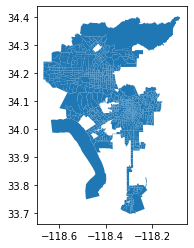

In [19]:
census.plot()

We rename the columns of the racial data from their census code to the racial category they represent.

In [20]:
columns_to_keep = ['geoid',
 'name',
 'B03002001',
 'B03002002',
 'B03002003',
 'B03002004',
 'B03002005',
 'B03002006',
 'B03002007',
 'B03002008',
 'B03002009',
 'B03002012',
 'geometry']

In [21]:
census = census[columns_to_keep]

In [22]:
census.columns = ['geoid',
 'name',
 'Total',
 'Non Hispanic',
 'White',
 'Black',
 'American Indian and Alaska Native',
 'Asian',
 'Native Hawaiian and Other Pacific Islander',
 'Some other race',
 'Two or more races',
 'Hispanic',
 'geometry']

Let's check the data.

In [23]:
census.head()

,geoid,name,Total,Non Hispanic,White,Black,American Indian and Alaska Native,Asian,Native Hawaiian and Other Pacific Islander,Some other race,Two or more races,Hispanic,geometry
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",4283.0,3095.0,2616.0,19.0,3.0,331.0,3.0,8.0,115.0,1188.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009..."
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",3405.0,3258.0,2882.0,74.0,15.0,220.0,0.0,0.0,67.0,147.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033..."
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",6347.0,3731.0,2986.0,198.0,0.0,486.0,0.0,47.0,14.0,2616.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979..."
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",3702.0,2338.0,1812.0,87.0,0.0,341.0,0.0,0.0,98.0,1364.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859..."
4,14000US06037101300,"Census Tract 1013, Los Angeles, CA",3884.0,3587.0,3126.0,205.0,0.0,194.0,0.0,0.0,62.0,297.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782..."


Now, let's drop the census tracts with a population less than 100.

In [24]:
census = census[census['Total'] > 100]

<AxesSubplot:>

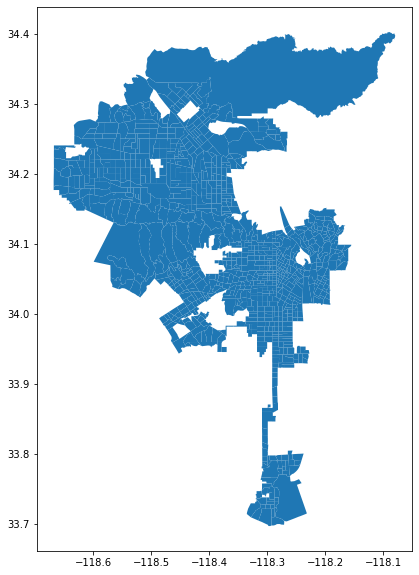

In [25]:
census.plot(figsize=(10,10))

Let's also check the geodataframe to make sure it loads the plot properly.

<AxesSubplot:>

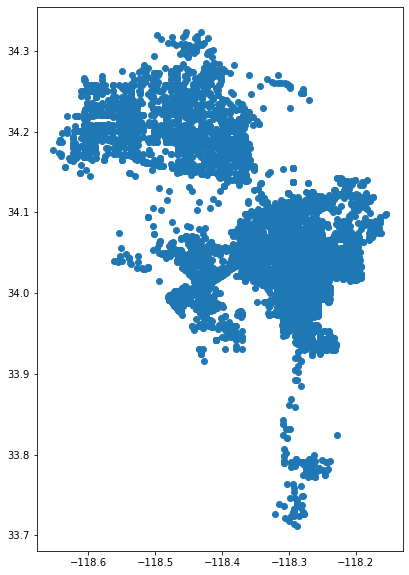

In [26]:
gdf.plot(figsize=(10,10))

Now that we've ensured the bike collisions are loaded correctly, let's use a spatial join to match them up with each census tract.

In [27]:
census_gdf = gpd.sjoin(census, gdf) #Spatial join Points to polygons
census_gdf

,geoid,name,Total,Non Hispanic,White,Black,American Indian and Alaska Native,Asian,Native Hawaiian and Other Pacific Islander,Some other race,...,MO_Codes,Victim Age,Victim Sex,Victim_Descent,Premise Code,Premise Description,Address,Cross Street,Lat,Long
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",4283.0,3095.0,2616.0,19.0,3.0,331.0,3.0,8.0,...,Veh vs Bike,24.0,F,Hispanic/Latin/Mexican,101.0,STREET,APPERSON ST,FOOTHILL BL,34.2560,-118.2979
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",4283.0,3095.0,2616.0,19.0,3.0,331.0,3.0,8.0,...,Veh vs Bike,26.0,M,Hispanic/Latin/Mexican,101.0,STREET,FOOTHILL,WYNGATE,34.2575,-118.3010
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",6347.0,3731.0,2986.0,198.0,0.0,486.0,0.0,47.0,...,Veh vs Bike,28.0,M,Other,101.0,STREET,FOOTHILL BL,DAY ST,34.2545,-118.2979
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",3702.0,2338.0,1812.0,87.0,0.0,341.0,0.0,0.0,...,Veh vs Bike,22.0,M,White,101.0,STREET,FOOTHILL BL,TUJUNGA CANYON BL,34.2476,-118.2794
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",3702.0,2338.0,1812.0,87.0,0.0,341.0,0.0,0.0,...,Veh vs Bike,NaN,M,Hispanic/Latin/Mexican,101.0,STREET,FOOTHILL,HAINES CANYON,34.2476,-118.2794
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1002,14000US06037980031,"Census Tract 9800.31, Los Angeles, CA",1175.0,788.0,393.0,232.0,26.0,36.0,24.0,25.0,...,Veh vs Bike,26.0,F,Hispanic/Latin/Mexican,101.0,STREET,7TH ST,HARBOR BL,33.7378,-118.2799
1002,14000US06037980031,"Census Tract 9800.31, Los Angeles, CA",1175.0,788.0,393.0,232.0,26.0,36.0,24.0,25.0,...,Veh vs Bike,39.0,F,Hispanic/Latin/Mexican,101.0,STREET,OFARRELL ST,CENTER ST,33.7489,-118.2798
1002,14000US06037980031,"Census Tract 9800.31, Los Angeles, CA",1175.0,788.0,393.0,232.0,26.0,36.0,24.0,25.0,...,Veh vs Bike,78.0,M,White,101.0,STREET,JOHN S GIBSON,HARBOR FY,33.7613,-118.2819
1002,14000US06037980031,"Census Tract 9800.31, Los Angeles, CA",1175.0,788.0,393.0,232.0,26.0,36.0,24.0,25.0,...,Veh vs Bike,40.0,M,Hispanic/Latin/Mexican,101.0,STREET,MINER AV,22ND ST,33.7262,-118.2783


Now we create a new dataframe called "MO_Codes" and merge it with the census data.

In [28]:
MO_Codes = census_gdf.value_counts('name').reset_index(name='MO_Codes')
MO_Codes

,name,MO_Codes
0,"Census Tract 2260.02, Los Angeles, CA",154
1,"Census Tract 2077.10, Los Angeles, CA",146
2,"Census Tract 2240.20, Los Angeles, CA",99
3,"Census Tract 2079, Los Angeles, CA",84
4,"Census Tract 2060.31, Los Angeles, CA",78
...,...,...
922,"Census Tract 1373.01, Los Angeles, CA",1
923,"Census Tract 1397.03, Los Angeles, CA",1
924,"Census Tract 1411.02, Los Angeles, CA",1
925,"Census Tract 1415, Los Angeles, CA",1


In [29]:
census = census.merge(MO_Codes, how='left', on='name')

In [30]:
census.head()

,geoid,name,Total,Non Hispanic,White,Black,American Indian and Alaska Native,Asian,Native Hawaiian and Other Pacific Islander,Some other race,Two or more races,Hispanic,geometry,MO_Codes
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",4283.0,3095.0,2616.0,19.0,3.0,331.0,3.0,8.0,115.0,1188.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009...",2.0
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",3405.0,3258.0,2882.0,74.0,15.0,220.0,0.0,0.0,67.0,147.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033...",NaN
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",6347.0,3731.0,2986.0,198.0,0.0,486.0,0.0,47.0,14.0,2616.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979...",1.0
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",3702.0,2338.0,1812.0,87.0,0.0,341.0,0.0,0.0,98.0,1364.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859...",6.0
4,14000US06037101300,"Census Tract 1013, Los Angeles, CA",3884.0,3587.0,3126.0,205.0,0.0,194.0,0.0,0.0,62.0,297.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782...",1.0


## Normalizing for Race and Bike Collision in the Dataframes
Next, we go ahead and normalize data for race. In addition, it should be noted that in normalizing data for bike collisions we used bike collision per 1000 residennts instead of using 100. We also included geometry as itself so that it would carry foward in the dataframe, since we needed this column for further mapping.

In [31]:
# normalizing for percent race, bike collision per 1000 residents, and keeping census geometry
census['Percent White'] = census['White']/census['Total']*100
census['Percent Black'] = census['Black']/census['Total']*100
census['Percent American Indian and Alaska Native'] = census['American Indian and Alaska Native']/census['Total']*100
census['Percent Asian'] = census['Asian']/census['Total']*100
census['Percent Hawaiian and Other Pacific Islander'] = census['Native Hawaiian and Other Pacific Islander']/census['Total']*100
census['Percent Some other race'] = census['Some other race']/census['Total']*100
census['Percent Two or more races'] = census['Two or more races']/census['Total']*100
census['Percent Hispanic'] = census['Hispanic']/census['Total']*100
census['Bike_Collisions_per_1000_residents'] = census['MO_Codes']/census['Total']*1000
census['geometry']= census['geometry']

Now, we test and check the dataframe again to confirm the percent race columns are loaded correctly.

In [32]:
census.sample(5)

,geoid,name,Total,Non Hispanic,White,Black,American Indian and Alaska Native,Asian,Native Hawaiian and Other Pacific Islander,Some other race,...,MO_Codes,Percent White,Percent Black,Percent American Indian and Alaska Native,Percent Asian,Percent Hawaiian and Other Pacific Islander,Percent Some other race,Percent Two or more races,Percent Hispanic,Bike_Collisions_per_1000_residents
923,14000US06037275603,"Census Tract 2756.03, Los Angeles, CA",2537.0,1926.0,1087.0,68.0,0.0,648.0,0.0,0.0,...,9.0,42.845881,2.680331,0.00000,25.541979,0.0,0.00000,4.848246,24.083563,3.547497
574,14000US06037209820,"Census Tract 2098.20, Los Angeles, CA",3073.0,269.0,76.0,62.0,0.0,117.0,0.0,7.0,...,11.0,2.473153,2.017572,0.00000,3.807354,0.0,0.22779,0.227790,91.246339,3.579564
957,14000US06037294421,"Census Tract 2944.21, Los Angeles, CA",2891.0,750.0,239.0,133.0,0.0,332.0,0.0,0.0,...,3.0,8.267036,4.600484,0.00000,11.483916,0.0,0.00000,1.591145,74.057420,1.037703
368,14000US06037183520,"Census Tract 1835.20, Los Angeles, CA",3758.0,772.0,553.0,9.0,1.0,76.0,0.0,0.0,...,4.0,14.715274,0.239489,0.02661,2.022352,0.0,0.00000,3.539117,79.457158,1.064396
782,14000US06037238320,"Census Tract 2383.20, Los Angeles, CA",3804.0,1325.0,38.0,1235.0,0.0,52.0,0.0,0.0,...,11.0,0.998948,32.465825,0.00000,1.366982,0.0,0.00000,0.000000,65.168244,2.891693


## Initial data and map analysis of Median Household Income by Census Tract

Let's look at citywide data for MHI by census tract to see the distribution across the city. Let's first clean the data columns though.

In [33]:
list(mhi)

['geoid', 'name', 'B19013001', 'B19013001, Error', 'geometry']

In [34]:
columns_to_keep = ['geoid', 'name', 'B19013001', 'geometry']

In [35]:
mhi = mhi[columns_to_keep]

In [36]:
mhi.columns = ['geoid', 'name', 'MHI', 'geometry']

In [37]:
mhi.head()

,geoid,name,MHI,geometry
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",63534.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009..."
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",90389.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033..."
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",44083.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979..."
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",43713.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859..."
4,14000US06037101300,"Census Tract 1013, Los Angeles, CA",81776.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782..."


We see that there is a positive skew towards census tracts with the highest income brackets. Let's create a more sophisticated histogram showing the mean and median and get more information on the dataframe. If the mean is higher than the median, it shows that there is a positive skew dragging the average up.

In [38]:
def get_histogram(column = 'MHI'):
    series_to_plot=mhi[column]

    plt.figure(figsize=(12,8))

    plt.hist(series_to_plot,bins=50,color='lightblue')

    plt.axvline(series_to_plot.mean(), color='k', linestyle='dashed', linewidth=1)
    plt.axvline(series_to_plot.median(), color='r', linestyle='dashed', linewidth=1)
    min_ylim, max_ylim = plt.ylim()
    plt.text(series_to_plot.mean()*1.1, max_ylim*0.9, 'Mean: {:.2f}'.format(series_to_plot.mean()))
    plt.text(series_to_plot.median()*1.1, max_ylim*0.8, 'Median: {:.2f}'.format(series_to_plot.median()),color='r')
    plt.title('Median Household Income by Census Tracts in City of LA')

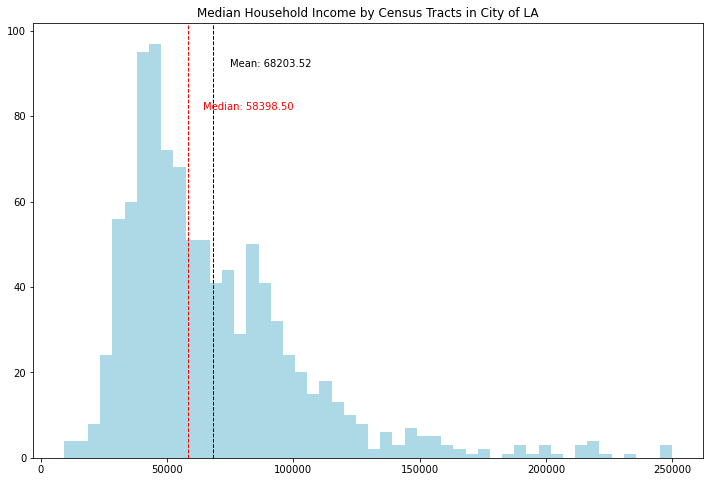

In [39]:
get_histogram()

In [40]:
mhi['MHI'].mean()

68203.51512096774

In [41]:
mhi['MHI'].median()

58398.5

In [42]:
mhi['MHI'].describe()

count       992.000000
mean      68203.515121
std       36642.300370
min        9191.000000
25%       42758.000000
50%       58398.500000
75%       85267.500000
max      250001.000000
Name: MHI, dtype: float64

*Note: The median MHI by census tract is different from the median household income of LA at-large, which was \\$67,431 per Census Reporter in the 2019 ACS Community Survey.*

Seeing the mean census tract MHI is higher than the median MHI, it looks like there are outlying census tracts with much higher MHI than a normal distribution would suggest.  Plotting the data and running this statistical analysis confirms LA contains outlying census tracts on the high end of MHI, with a positively-skewed distribution shown in the histogram. The highest frequency of census tract MHI is around \\$50,000, and the median is slightly higher at \\$58,000. However, there are are smaller frequencies of much higher MHI, with the highest at almost \\$250,000 MHI. The 75th percentile of all census tracts is only \\$85,268, which less than half of the highest end census tracts. As a result, the mean is about \\$10,000 higher than the median, indicating that the highest income levels are making the average MHI of LA higher than the majority of census tracts. 

This finding informs us to perform a multivariate regression later in the project to determine if bike collisions correlate with the MHI (among other groups like racial makeup) of census tracts in LA. But first, we want to visually determine if bike infrastructure correlates with the MHI of census tracts in LA via a map.

In [43]:
mhi_web_mercator = mhi.to_crs(epsg=3857)
bwy_web_mercator = bwy.to_crs(epsg=3857)
census_web_mercator = census.to_crs(epsg=3857)

In [44]:
from matplotlib.colors import ListedColormap

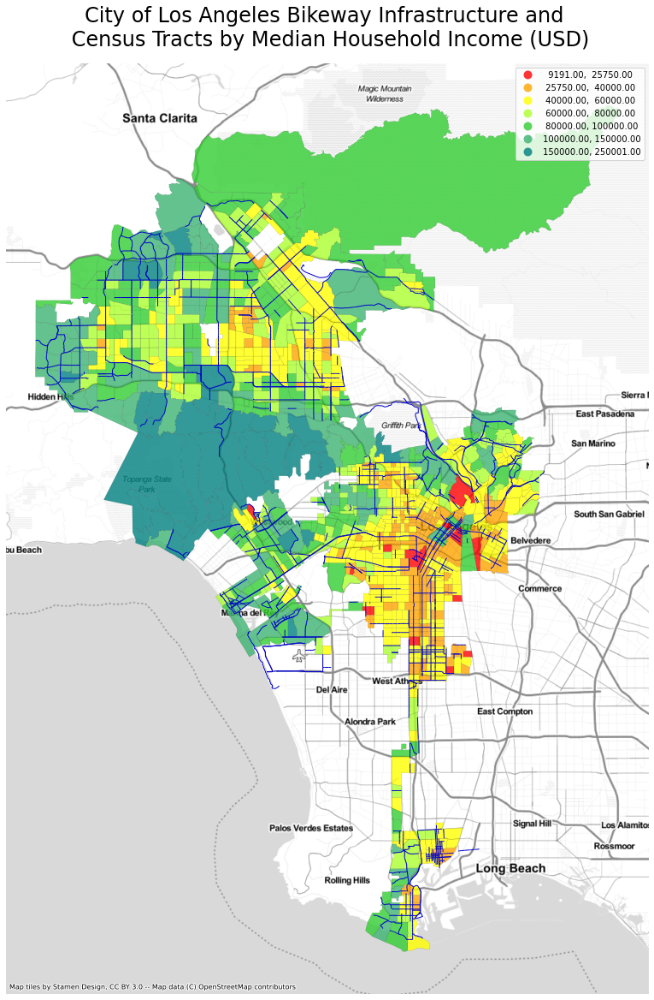

In [45]:
fig, ax = plt.subplots(figsize= (20,20))

mhi_web_mercator[mhi_web_mercator['MHI'] > 0].plot(
    ax = ax,
    column= 'MHI', 
    cmap = ListedColormap(['red', 'orange', 'yellow', 'greenyellow', 'limegreen', 'mediumseagreen', 'teal']),
    legend = True, 
    scheme = 'user_defined', 
    classification_kwds={'bins':[25750,40000,60000,80000,100000,150000]}, 
    edgecolor = 'black', 
    linewidth = 0.1, 
    alpha= 0.8
)

bwy_web_mercator.plot(
    ax=ax,
    alpha= 1,
    edgecolor = 'mediumblue',
    linewidth = 1
)

ax.axis('off')

ax.set_title('City of Los Angeles Bikeway Infrastructure and \n Census Tracts by Median Household Income (USD)', fontsize=24, pad=20)

ctx.add_basemap(ax,source=ctx.providers.Stamen.TonerLite)

This static visual is not used in the storymap due to its cluttered nature, which ultimately led us to use folium as it allows the user to see both the city at-large but see individual neighborhood differences. However, but there are some interesting things to point out. The richest parts of LA in blue and purple have virtually zero bike paths, but this appears to be partly explained by the tough terrain and narrow streets of the hillsides that would prohibit bike lanes. At the same time, existing residents' political and financial power to resist new bike lanes may also play a role as well. This map does show, however, that there are a lot of intersecting bike lanes in DTLA where there are also wealthy and much less wealthy census tracts bordering each other. 

## Folium: Marker Cluster Map of Individual Bike Collisions across City of LA

For our interactive map, we use folium to load the points for each bike collision from the LAPD data. The cluster mapping consolidates all of the points in a given area when zoomed out. As you zoom in to neighborhoods and cross-streets, each point represents the latitude and longitude coordinates of individual bike collisions.

In [46]:
gdf.head()

,DR Number,Date Reported,Date Occurred,Time Occurred,Area ID,Area Name,Reporting District,Crime Code,Crime Code Description,MO_Codes,Victim Age,Victim Sex,Victim_Descent,Premise Code,Premise Description,Address,Cross Street,Lat,Long,geometry
0,190617851,8/24/19,8/24/19,1115,6,Hollywood,615,997,TRAFFIC COLLISION,Veh vs Bike,52.0,M,White,101.0,STREET,BARHAM BL,WINNIE DR,34.1347,-118.3427,POINT (-118.34270 34.13470)
1,190715500,8/22/19,8/21/19,2230,7,Wilshire,727,997,TRAFFIC COLLISION,Veh vs Bike,24.0,F,Hispanic/Latin/Mexican,101.0,STREET,BEVERLY BL,LA BREA AV,34.0762,-118.3441,POINT (-118.34410 34.07620)
2,190715796,8/27/19,8/27/19,1420,7,Wilshire,745,997,TRAFFIC COLLISION,Veh vs Bike,46.0,M,Other,101.0,STREET,LA BREA AV,SYCAMORE AV,34.0562,-118.3449,POINT (-118.34490 34.05620)
3,190814721,8/22/19,8/22/19,1730,8,West LA,842,997,TRAFFIC COLLISION,Veh vs Bike,32.0,M,White,101.0,STREET,SANTA MONICA BL,BARRINGTON AV,34.0465,-118.4588,POINT (-118.45880 34.04650)
4,190814726,8/20/19,8/20/19,825,8,West LA,851,997,TRAFFIC COLLISION,Veh vs Bike,24.0,M,Other Asian,101.0,STREET,BROCKTON AV,SANTA MONICA BL,34.0398,-118.4598,POINT (-118.45980 34.03980)


Here we are cleaning the data so that we only keep the columns that we are interested in.

In [47]:
gdf_mini = gdf[['MO_Codes','Victim_Descent','Lat','Long']].copy()

In [48]:
gdf_mini.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8744 entries, 0 to 8743
Data columns (total 4 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   MO_Codes        8744 non-null   object 
 1   Victim_Descent  8680 non-null   object 
 2   Lat             8744 non-null   float64
 3   Long            8744 non-null   float64
dtypes: float64(2), object(2)
memory usage: 273.4+ KB


In [49]:
# convert lat/lon's to floats
gdf_mini['Lat'] = gdf_mini['Lat'].astype(float)
gdf_mini['Long'] = gdf_mini['Long'].astype(float)
gdf_mini.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8744 entries, 0 to 8743
Data columns (total 4 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   MO_Codes        8744 non-null   object 
 1   Victim_Descent  8680 non-null   object 
 2   Lat             8744 non-null   float64
 3   Long            8744 non-null   float64
dtypes: float64(2), object(2)
memory usage: 273.4+ KB


Now we create the folium marker cluster map for bike collisions.

In [50]:
from folium.plugins import MarkerCluster

In [51]:
# create a list of lat/lon pair for UCLA
ucla = [34.0721237,-118.4440685]
m = folium.Map(location=ucla, zoom_start=10, tiles = 'cartodbpositron')


marker_cluster = MarkerCluster().add_to(m)

for index,row in gdf_mini.iterrows():
    folium.Marker(
        location=[row.Lat,row.Long],
        popup=row.MO_Codes,
        icon=folium.Icon(color="red", icon="ok-sign"),
    ).add_to(marker_cluster)

folium.GeoJson("City_of_Los_Angeles_Bikeways.geojson", name="Bikelane").add_to(m)

m

In [ ]:
# saving the map as html to load onto Github and embed in Storymaps
m.save('bikeaccidentsfolium.html')

## Creating Map Bikeways and Bike Collision per 1000 residents

Now we load the bikeway and bike collision data. We then normalize the bike collisions within each census tract to collisions per 1000 residents. Afterwards, we plot both sets of data on top of each other to see if there is a correlating pattern. 

In [ ]:
bikelane = gpd.read_file('City_of_Los_Angeles_Bikeways.geojson')

In [ ]:
bikelane.head()

Here we are mapping bike collisions per 1,000 residents overlayed with bike lanes in on LA. 

In [ ]:
# Here we are mapping bike collisions per 1,000 residents overlayed with bike lanes in on LA.
fig,ax = plt.subplots(figsize=(12,12))

census.plot(ax=ax,column='Bike_Collisions_per_1000_residents',legend=True,cmap='OrRd',scheme='NaturalBreaks')

bikelane.plot(ax=ax)

ax.set_title("Bike Collisions per 1,000 residents and Bike Lanes in LA",fontsize=24,pad=20)

# get rid of the axes in the map
ax.axis('off');

### Creating Folium Map of Choropleth Bike Collision Map with Bike Lanes

In this next section we are creating a subset dataframe from census to include geoid, bike collision per 1000 residents and geometry. We define this dataframe as census_mini.

In [ ]:
# Here we are changing geoid so that it is string format.
census_mini = census[['geoid','Bike_Collisions_per_1000_residents','geometry']].copy()

In [ ]:
# Here we have to drop rows with NaN in Bike_Collision_per_1000 residents so that they don't show up as gray in our map.
census_mini['geoid'] = census_mini.index.astype(str)

In [ ]:
# Here we have to drop rows with NaN in Bike_Collision_per_1000 residents so that they don't show up as gray in our map.
census_mini=census_mini.dropna(subset = ['Bike_Collisions_per_1000_residents'], axis=0)

In [ ]:
# Here we are testing the dataframe we created.
census_mini.head()

We are now creating Web Mercator projections because we are loading a basemap with latitude longitude coordinates, so we convert ehc geometries to Mercator projection.

*consider putting in neighborhood choropleth if possible*

In [ ]:
mhi_web_mercator = mhi.to_crs(epsg=3857)
bwy_web_mercator = bwy.to_crs(epsg=3857)
census_web_mercator = census.to_crs(epsg=3857)

In [ ]:
# Re-project to WGS84
census_mini = census_mini.to_crs(epsg=4326)

# Check layer crs definition
print(census_mini.crs)

In [ ]:
# Here we put everything together so that we are able to map a folium map of the static choropeth map showing maps we previously mapped.

n = folium.Map(location=[34.0522, -118.2437],tiles = 'cartodbpositron', zoom_start=10, control_scale=True)

# Plot a choropleth map
# Notice: 'geoid' column that we created earlier needs to be assigned always as the first column
folium.Choropleth(
    geo_data=census_mini,
    name='Bike_Collisions_per_1000_residents',
    data=census_mini,
    columns=['geoid','Bike_Collisions_per_1000_residents'],
    key_on='feature.id',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    line_color='white',
    line_weight=0,
    highlight=False,
    smooth_factor=1.0,
    legend_name= 'Bike Collisions per 1,000 residents').add_to(n)

#include bikelanes
folium.GeoJson("City_of_Los_Angeles_Bikeways.geojson", name="Bikelane").add_to(n)



#Show map
n

In these map we see bike collisions concentrations by census tracts. So the darker the census tracts the higher count of bike collisions that census tract has had. Here we see that Downtown LA and Skid Row (officially know as Central City East) have the highest number of reported bike collisions. In these areas, where bike collision is high we are able to see that there is lack of bike infrastructure.


In [ ]:
# saving the map as html to load onto Github and embed in Storymaps
n.save("collisions_bikeways.html")

In [ ]:
collision_by_descent = gdf.value_counts('Victim_Descent').reset_index(name='count')
collision_by_descent

Looking at the counts for ‘Bike Collisions by Victim Descent’ we see that the top three race groups involved in bike collisions are Hispanics, White, and Black. 

# Downtown LA case study and analysis

## Identifying specific census tracts lying within Downtown LA
Here we used censusreporter.org to identify the individual census tracts that lie within DTLA.

I obtained the neighborhood of Downtown LA from Census Explorer as defined by LA Times "Mapping LA" project.

In [ ]:
mhi.sample(1)

In [ ]:
# locating DTLA census tracts in web mercator dataframe with MHI data
dtla = mhi_web_mercator.loc[mhi['geoid'].isin(['14000US06037207400',
                                               '14000US06037207501',
                                               '14000US06037207502',
                                               '14000US06037207710',
                                               '14000US06037207301',
                                               '14000US06037207302',
                                               '14000US06037206031',
                                               '14000US06037206300',
                                               '14000US06037226002',
                                               '14000US06037224010',
                                               '14000US06037206300',
                                               '14000US06037207900',
                                               '14000US06037206200'
                                                                    ])]

In [ ]:
# locating DTLA census tracts in web mercator dataframe with race data
dtla_race = census_web_mercator.loc[census['geoid'].isin(['14000US06037207400',
                                               '14000US06037207501',
                                               '14000US06037207502',
                                               '14000US06037207710',
                                               '14000US06037207301',
                                               '14000US06037207302',
                                               '14000US06037206031',
                                               '14000US06037206300',
                                               '14000US06037226002',
                                               '14000US06037224010',
                                               '14000US06037206300',
                                               '14000US06037207900',
                                               '14000US06037206200'
                                                                    ])]

In [ ]:
# make sure all 12 DTLA census tracts are loaded for race data
dtla_race

In [ ]:
# make sure all 12 DTLA census tracts are loaded for MHI data
dtla

In [ ]:
# ensure the dataframes have the same geometry
dtla.plot()
dtla_race.plot()

### Creating Neighborhoods Outline Layer Using Dissolve
Here we create an outline for the overarching "neighborhoods" we have identified: Arts District (just census tract 2060.31 xxx)

In [ ]:
# create new 'neighborhood' column with matching neighborhood names to census tracts for MHI
dtla['n1'] = ['Tract 2060.31, Arts District', 
                        'Tract 2062.00, Skid Row', 
                        'Tract 2063.00, Skid Row', 
                        'Tract 2073.01, Other DLTA', 
                        'Tract 2073.02, Skid Row', 
                        'Tract 2074.00, Other DTLA', 
                        'Tract 2075.01, Other DTLA',                        
                        'Tract 2075.02, Other DTLA', 
                        'Tract 2077.10, Other DTLA', 
                        'Tract 2079.00, Other DTLA', 
                        'Tract 2240.10, Other DTLA', 
                        'Tract 2260.02, Skid Row']

In [ ]:
# create new 'neighborhood' column with matching neighborhoods for race (same as MHI dataframe)
dtla_race['n1'] = ['Tract 2060.31, Arts District', 
                        'Tract 2062.00, Skid Row', 
                        'Tract 2063.00, Skid Row', 
                        'Tract 2073.01, Other DLTA', 
                        'Tract 2073.02, Skid Row', 
                        'Tract 2074.00, Other DTLA', 
                        'Tract 2075.01, Other DTLA',                        
                        'Tract 2075.02, Other DTLA', 
                        'Tract 2077.10, Other DTLA', 
                        'Tract 2079.00, Other DTLA', 
                        'Tract 2240.10, Other DTLA', 
                        'Tract 2260.02, Skid Row']

In [ ]:
dtla['n2'] = ['Arts District',
                   'Skid Row',
                   'Skid Row',
                   'Other DTLA',
                   'Skid Row',
                   'Other DTLA',
                   'Other DTLA',
                   'Other DTLA',
                   'Other DTLA',
                   'Other DTLA',
                   'Other DTLA',
                   'Skid Row'
                  ]

In [ ]:
dtla_race['n2'] = ['Arts District',
                   'Skid Row',
                   'Skid Row',
                   'Other DTLA',
                   'Skid Row',
                   'Other DTLA',
                   'Other DTLA',
                   'Other DTLA',
                   'Other DTLA',
                   'Other DTLA',
                   'Other DTLA',
                   'Skid Row'
                  ]

In [ ]:
dtla

In [ ]:
#re-index rows for both MHI and race based on neighborhood so census tracts are grouped together
dtla = dtla.reindex([535, 536, 541, 702, 532, 540, 542, 543, 544, 545, 546, 692])
dtla_race = dtla_race.reindex([535, 536, 541, 702, 532, 540, 542, 543, 544, 545, 546, 692])


In [ ]:
#check data
dtla

In [ ]:
neighborhood = dtla.dissolve(by='n2')

In [ ]:
neighborhood.plot()

In [ ]:
neighborhood

In [ ]:
# neighborhood outline map - colored in to determine each individual census tract's location + dissolved neighborhoods outlined
fig,ax = plt.subplots(figsize=(15,15))

# individual census tracts
dtla.plot(ax=ax,column='n1',
          legend=True, 
          cmap='tab20',
          edgecolor = 'black', 
          linewidth = 1, 
          alpha= 0.8)

neighborhood.plot(ax=ax, 
                  legend=True, 
                  edgecolor = 'black',
                  facecolor = 'none',
                  linewidth = 4, alpha= 0.5)

ax.set_title("Census Tracts and Neighborhoods in Downtown LA",fontsize=24,pad=20)

#manual axis set to DTLA confines
ax.set_ylim(4029000, 4039000)
ax.set_xlim(-13170000, -13155000)

# get rid of the axis
ax.axis('off');

ctx.add_basemap(ax,source=ctx.providers.Stamen.TonerLite)

## Creating a static map of Downtown LA Bike Lanes and Census Tracts by MHI

In [ ]:
fig, ax = plt.subplots(figsize= (15,15))

dtla[dtla['MHI'] > 0].plot(
    ax = ax,
    column= 'MHI', 
    cmap = ListedColormap(['red', 'orange', 'yellow', 'greenyellow', 'limegreen', 'mediumseagreen', 'teal']),
    legend = True, 
    scheme = 'user_defined', 
    classification_kwds={'bins':[25750,42758,58398,85268,100000,150000]}, 
    edgecolor = 'black', 
    linewidth = 0.5, 
    alpha= 0.7
)

neighborhood.plot(ax=ax, 
                  legend=True, 
                  edgecolor = 'black', 
                  facecolor = 'none',
                  linewidth = 4, alpha= 0.8)

bwy_web_mercator.plot(
    ax=ax,
    alpha= 1,
    edgecolor = 'mediumblue',
    linewidth = 2
)

ax.set_ylim(4029000, 4039000)
ax.set_xlim(-13170000, -13155000)

ax.axis('off')

ax.set_title('Downtown LA Bike Infrastructure and \n Census Tracts by Median Household Income (USD)', fontsize=24, pad=20)

ctx.add_basemap(ax,source=ctx.providers.Stamen.TonerLite)

## Creating a for loop of Downtown LA maps by each race

Using a for loop reduces the amount of repeating code we are using for each race by creating lists for pieces of the code that will change. We want different color maps for each map, so we create a second list called cmaps. After that, we use the zip() function in the for loop to merge the two lists, race and cmaps, to match the plot of each race with their respective color map. In the for loop, race and cmaps are designated as x and y, respectively.

In [ ]:
# we want the column names we will be keeping for the for loop of maps by race.
census.sample(1)

In [ ]:
# creating a list identifying columns to keep in for loop
race = ['Percent White',
 'Percent Black',
 'Percent American Indian and Alaska Native',
 'Percent Asian',
 'Percent Hawaiian and Other Pacific Islander',
 'Percent Some other race',
 'Percent Hispanic']

In [ ]:
print(race)

In [ ]:
# creating different colormaps for the maps of each race in the for loop
cmaps = ['Oranges', 
         'YlGn', 
         'RdPu', 
         'PuRd', 
         'YlOrBr',
         'Reds',
         'Purples']

In [ ]:
print(cmaps)

In [ ]:
for x, y in zip(race, cmaps): 
    fig,ax = plt.subplots(figsize=(15,15))
        
    dtla_race.plot(ax=ax,
            column=x,
            legend=True,
            scheme = 'user_defined', 
            classification_kwds={'bins':[10,20,30,40,50,60]},
            cmap=y,
            edgecolor='black',
            linewidth = 0.5,
            alpha=.7)

    bwy_web_mercator.plot(
        ax=ax,
        alpha= 1,
        edgecolor = 'mediumblue',
        linewidth = 2
    )
    
    neighborhood.plot(ax=ax, 
                      legend=True, 
                      edgecolor = 'black', 
                      facecolor = 'none',
                      linewidth = 4, alpha= 0.8)

    ax.axis('off')

    ax.set_ylim(4029000, 4039000)
    ax.set_xlim(-13170000, -13155000)

    ax.set_title('Downtown LA Bike Infrastructure and \n Census Tract by ' + x, fontsize=24, pad=20)

    ctx.add_basemap(ax,source=ctx.providers.Stamen.TonerLite)

## Creating Bar Charts for DTLA Census Tracts by MHI and Race

### Creating Bar Chart for MHI 

Before creating the graphs, we want create two new columns. The first column is to relabel each census tract by just its census tract number and its neighborhood. The three neighborhoods identified are Skid Row, Arts District, and other parts of Downtown LA. Note that there is no official designation by the City of LA for neighborhood boundaries, so each neighborhood may not align exactly with the census tracts. The second column is to assign each census tract a color corresponding to its defined neighborhood. 

reorder row index to align census tracts within same neighborhood next to each other

In [ ]:
# looking at order of census tracts to manually assign new neighborhood names and corresponding colors
dtla

In [ ]:
# manually assign colors for each census tract in a new column based on the neighborhood
dtla['colors'] = ['#00CCCC',
                  '#00CCCC',
                  '#00CCCC',
                  '#00CCCC',
                  '#999900',
                  '#9933FF', 
                  '#9933FF',
                  '#9933FF',
                  '#9933FF', 
                  '#9933FF', 
                  '#9933FF', 
                  '#9933FF']

In [ ]:
# Bar graph of MHI per census tract, with each bar colored by neighborhood: Arts District, Skid Row, Other DTLA
fig,ax = plt.subplots(figsize=(12,6))

plt.bar(range(len(dtla)), 
        dtla["MHI"], 
        color = dtla["colors"],
       )
plt.title('Median Household Income by Census Tract \n in Downtown LA Neighborhoods', fontsize=24, pad=20)
plt.axhline(67418, color='r', linestyle='dashed', linewidth=1)
min_xlim, max_xlim = plt.xlim()
plt.xticks(range(len(dtla['n1'])), dtla['n1'], rotation='vertical')
plt.rc('xtick', labelsize=16)
plt.text(max_xlim*1.01, 67418*.975, 'Citywide \n   MHI: \n{:.2f}'.format(67418),color='r')


In [ ]:
# create new dataframe for all census tracts in LA, sorted by ascending MHI values
mhi_sorted = mhi.sort_values(by='MHI',ascending = True)

In [ ]:
# show that census tract 2063 in heart of Skid Row has lowest MHI in all of LA, also 2075.02 in other part of DTLA (Bunker Hill) is 8th lowest MHI in all of LA
mhi_sorted.head(10)

### Creating Bar Chart for Race 

We do the exact same as the previous bar chart: relabelling the census tracts and reindexing the order of the census tracts by neighborhood. We do not create color-coding by neighborhood for this chart because each color in the bar chart corresponds to a specific race.

In [ ]:
# confirm 'neighborhood' column is loaded into dtla_race dataframe
dtla_race

In [ ]:
# Bar graph of MHI per census tract, with each census tract containing four bars and corresponding colors for each race
dtla_race.plot(figsize=(12,6), 
               x="n1", 
               y=["Percent White", "Percent Black", "Percent Hispanic", "Percent Asian",], 
               kind="bar",
              fontsize=16)

plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')

plt.title('Race Percent by Census Tract', fontsize=24, pad=20)

## Contributions

* Bailey:
  * Write-up of notebook
  * Socioeconomics: Median household income data + all visuals associated with MHI 
  * Neighborhood outline layers + map
  * Code-testing + finalizing Jupyter notebook
* Monica:
  * Write-up of notebook
  * Bike collision maps by race
  * Bike collision maps by type and victim descent
  * Folium interactive maps 
